In [1]:
# from google.colab import drive
# drive.mount('/content/drive')
# Install TensorFlow Object Detection API dependencies
# !apt-get install -y build-essential python-dev
# !pip install tensorflow-object-detection
# !pip install pycocotools

!pip install -U -q "tf-models-official"
import os
import io
import pprint
import tempfile
import matplotlib
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt

from PIL import Image
from six import BytesIO
from IPython import display
from urllib.request import urlopen

import orbit
import tensorflow_models as tfm

from official.core import exp_factory
from official.core import config_definitions as cfg
from official.vision.serving import export_saved_model_lib
from official.vision.ops.preprocess_ops import normalize_image
from official.vision.ops.preprocess_ops import resize_and_crop_image
from official.vision.utils.object_detection import visualization_utils
from official.vision.dataloaders.tf_example_decoder import TfExampleDecoder

%matplotlib inline

# 2nd Method
!git clone --depth 1 https://github.com/tensorflow/models.git


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.7/2.7 MB 12.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 106.7/106.7 kB 12.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 43.6/43.6 kB 5.4 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 242.5/242.5 kB 15.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.2/5.2 MB 34.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 589.8/589.8 MB 2.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.7/1.7 MB 82.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.3/5.3 MB 92.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.2/2.2 MB 80.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.5/5.5 MB 82.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 73.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 311.2/311.2 kB 24.1 MB/s eta 0:0

In [2]:
pp = pprint.PrettyPrinter(indent=4) # Set Pretty Print Indentation
print(tf.__version__) # Check the version of tensorflow used

2.16.1


In [3]:
logical_device_names = [logical_device.name for logical_device in tf.config.list_logical_devices()]

if 'GPU' in ''.join(logical_device_names):
  print('This may be broken in Colab.')
  device = 'GPU'
elif 'TPU' in ''.join(logical_device_names):
  print('This may be broken in Colab.')
  device = 'TPU'
else:
  print('Running on CPU is slow, so only train for a few steps.')
  device = 'CPU'

This may be broken in Colab.


In [4]:
!curl -L 'https://app.roboflow.com/ds/fsV8Pe63E8?key=F4nVTVeFFi' > './Dermafie.v2.coco.zip'
!unzip -q -o './Dermafie.v2.coco.zip' -d './Dermafie.v2.coco/'
!rm './Dermafie.v2.coco.zip'

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100   901  100   901    0     0   3462      0 --:--:-- --:--:-- --:--:--  3452
100 68.2M  100 68.2M    0     0  41.0M      0  0:00:01  0:00:01 --:--:-- 78.7M


In [5]:
%%bash

TRAIN_DATA_DIR='./Dermafie.v2.coco/train'
TRAIN_ANNOTATION_FILE_DIR='./Dermafie.v2.coco/train/_annotations.coco.json'
OUTPUT_TFRECORD_TRAIN='./dermafie_coco_tfrecords/train'

# Need to provide
  # 1. image_dir: where images are present
  # 2. object_annotations_file: where annotations are listed in json format
  # 3. output_file_prefix: where to write output convered TFRecords files
python -m official.vision.data.create_coco_tf_record --logtostderr \
  --image_dir=${TRAIN_DATA_DIR} \
  --object_annotations_file=${TRAIN_ANNOTATION_FILE_DIR} \
  --output_file_prefix=$OUTPUT_TFRECORD_TRAIN \
  --num_shards=1

2024-06-10 15:32:51.787836: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
I0610 15:32:54.660701 137987693318144 create_coco_tf_record.py:502] writing to output path: ./dermafie_coco_tfrecords/train
I0610 15:32:54.689204 137987693318144 create_coco_tf_record.py:374] Building bounding box index.
I0610 15:32:54.690523 137987693318144 create_coco_tf_record.py:385] 0 images are missing bboxes.
/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
I0610 15:32:55.665507 137987693318144 tfrecord_lib.py:168] On image 0
I0610 15:32:55.690732 137987693318144 tfrecord_lib.py:168] On image 100
I0610 15:32:55.710976 137987693318144 tfrecord_lib.py:168] On image 200
I0610 15:32:55.726236 137987693318144 tfrecord_lib.py:168] On image 300
I0610 15:32:55.741497 137987693318144 tf

In [6]:
%%bash

VALID_DATA_DIR='./Dermafie.v2.coco/valid'
VALID_ANNOTATION_FILE_DIR='./Dermafie.v2.coco/valid/_annotations.coco.json'
OUTPUT_TFRECORD_VALID='./dermafie_coco_tfrecords/valid'

python -m official.vision.data.create_coco_tf_record --logtostderr \
  --image_dir=$VALID_DATA_DIR \
  --object_annotations_file=$VALID_ANNOTATION_FILE_DIR \
  --output_file_prefix=$OUTPUT_TFRECORD_VALID \
  --num_shards=1

2024-06-10 15:33:01.718678: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
I0610 15:33:09.244302 134070288564224 create_coco_tf_record.py:502] writing to output path: ./dermafie_coco_tfrecords/valid
I0610 15:33:09.253280 134070288564224 create_coco_tf_record.py:374] Building bounding box index.
I0610 15:33:09.253604 134070288564224 create_coco_tf_record.py:385] 0 images are missing bboxes.
/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
I0610 15:33:09.555022 134070288564224 tfrecord_lib.py:168] On image 0
I0610 15:33:09.574795 134070288564224 tfrecord_lib.py:168] On image 100
I0610 15:33:09.635860 134070288564224 tfrecord_lib.py:180] Finished writing, skipped 0 annotations.
I0610 15:33:09.638591 134070288564224 create_coco_tf_record.py:537] Finished writing

In [7]:
%%bash

TEST_DATA_DIR='./Dermafie.v2.coco/test'
TEST_ANNOTATION_FILE_DIR='./Dermafie.v2.coco/test/_annotations.coco.json'
OUTPUT_TFRECORD_TEST='./dermafie_coco_tfrecords/test'

python -m official.vision.data.create_coco_tf_record --logtostderr \
  --image_dir=$TEST_DATA_DIR \
  --object_annotations_file=$TEST_ANNOTATION_FILE_DIR \
  --output_file_prefix=$OUTPUT_TFRECORD_TEST \
  --num_shards=1

2024-06-10 15:33:14.514535: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
I0610 15:33:22.242557 137158772473856 create_coco_tf_record.py:502] writing to output path: ./dermafie_coco_tfrecords/test
I0610 15:33:22.246905 137158772473856 create_coco_tf_record.py:374] Building bounding box index.
I0610 15:33:22.247160 137158772473856 create_coco_tf_record.py:385] 0 images are missing bboxes.
/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
I0610 15:33:22.451327 137158772473856 tfrecord_lib.py:168] On image 0
I0610 15:33:22.484923 137158772473856 tfrecord_lib.py:180] Finished writing, skipped 0 annotations.
I0610 15:33:22.486152 137158772473856 create_coco_tf_record.py:537] Finished writing, skipped 0 annotations.


In [8]:
train_data_input_path = './dermafie_coco_tfrecords/train-00000-of-00001.tfrecord'
valid_data_input_path = './dermafie_coco_tfrecords/valid-00000-of-00001.tfrecord'
test_data_input_path = './dermafie_coco_tfrecords/test-00000-of-00001.tfrecord'
model_dir = './trained_model/'
export_dir ='./exported_model/'

In [9]:
exp_config = exp_factory.get_exp_config('retinanet_resnetfpn_coco')
pp.pprint(exp_config.as_dict())
display.Javascript('google.colab.output.setIframeHeight("500px");')

{   'runtime': {   'all_reduce_alg': None,
                   'batchnorm_spatial_persistent': False,
                   'dataset_num_private_threads': None,
                   'default_shard_dim': -1,
                   'distribution_strategy': 'mirrored',
                   'enable_xla': False,
                   'gpu_thread_mode': None,
                   'loss_scale': None,
                   'mixed_precision_dtype': 'bfloat16',
                   'num_cores_per_replica': 1,
                   'num_gpus': 0,
                   'num_packs': 1,
                   'per_gpu_thread_count': 0,
                   'run_eagerly': False,
                   'task_index': -1,
                   'tpu': None,
                   'tpu_enable_xla_dynamic_padder': None,
                   'use_tpu_mp_strategy': False,
                   'worker_hosts': None},
    'task': {   'allow_image_summary': False,
                'annotation_file': 'coco/instances_val2017.json',
                'differential_p

<IPython.core.display.Javascript object>

In [10]:
%cd /content

!wget "https://storage.googleapis.com/tf_model_garden/vision/resnet/resnet-50-i224.tar.gz"

!mkdir "./resnet50-ckpt/"

!tar -xzvf "./resnet-50-i224.tar.gz" -C "./resnet50-ckpt/"

!rm resnet-50-i224.tar.gz

/content
--2024-06-10 15:33:24--  https://storage.googleapis.com/tf_model_garden/vision/resnet/resnet-50-i224.tar.gz
Resolving storage.googleapis.com (storage.googleapis.com)... 74.125.20.207, 74.125.197.207, 74.125.135.207, ...
Connecting to storage.googleapis.com (storage.googleapis.com)|74.125.20.207|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 95252293 (91M) [application/x-tar]
Saving to: ‘resnet-50-i224.tar.gz’

resnet-50-i224.tar. 100%[===================>]  90.84M   173MB/s    in 0.5s    

2024-06-10 15:33:24 (173 MB/s) - ‘resnet-50-i224.tar.gz’ saved [95252293/95252293]

ckpt-62400.data-00000-of-00001
ckpt-62400.index


In [11]:
exp_config = exp_factory.get_exp_config('retinanet_resnetfpn_coco')
# alternative experiments available such as retinanet_resnetfpn_coco, retinanet_spinenet_coco, fasterrcnn_resnetfpn_coco

In [12]:
batch_size = 32
num_classes = 9

HEIGHT, WIDTH = 640, 640
IMG_SIZE = [HEIGHT, WIDTH, 3]

In [13]:
# Backbone config.
exp_config.task.init_checkpoint = "/content/resnet50-ckpt/ckpt-62400"
exp_config.task.init_checkpoint_modules ="backbone"
exp_config.task.freeze_backbone = True
exp_config.task.annotation_file = ''

# Model config.
exp_config.task.model.input_size = IMG_SIZE
exp_config.task.model.num_classes = num_classes + 1
exp_config.task.model.detection_generator.tflite_post_processing.max_classes_per_detection = exp_config.task.model.num_classes

# Training data config.
exp_config.task.train_data.input_path = train_data_input_path
exp_config.task.train_data.dtype = 'float32'
exp_config.task.train_data.global_batch_size = batch_size
exp_config.task.train_data.parser.aug_scale_max = 1.0
exp_config.task.train_data.parser.aug_scale_min = 1.0

# Validation data config.
exp_config.task.validation_data.input_path = valid_data_input_path
exp_config.task.validation_data.dtype = 'float32'
exp_config.task.validation_data.global_batch_size = batch_size

# Enabling Per Class Metrics
exp_config.task.per_category_metrics=True

In [14]:
exp_config.task.freeze_backbone = True
#exp_config.task.train_data.parser.aug_scale_max = 1.0
#exp_config.task.train_data.parser.aug_scale_min = 1.0

train_steps = 3000
exp_config.trainer.steps_per_loop = 100 # steps_per_loop = num_of_training_examples // train_batch_size

exp_config.runtime.num_gpus = 1
exp_config.trainer.summary_interval = 100
exp_config.trainer.checkpoint_interval = 100
exp_config.trainer.validation_interval = 100
exp_config.trainer.validation_steps =  100 # validation_steps = num_of_validation_examples // eval_batch_size
exp_config.trainer.train_steps = train_steps
exp_config.trainer.optimizer_config.warmup.linear.warmup_steps = 100
exp_config.trainer.optimizer_config.learning_rate.type = 'cosine'
exp_config.trainer.optimizer_config.learning_rate.cosine.decay_steps = train_steps
exp_config.trainer.optimizer_config.learning_rate.cosine.initial_learning_rate = 0.1
exp_config.trainer.optimizer_config.warmup.linear.warmup_learning_rate = 0.05

In [15]:
pp.pprint(exp_config.as_dict())
display.Javascript('google.colab.output.setIframeHeight("500px");')

{   'runtime': {   'all_reduce_alg': None,
                   'batchnorm_spatial_persistent': False,
                   'dataset_num_private_threads': None,
                   'default_shard_dim': -1,
                   'distribution_strategy': 'mirrored',
                   'enable_xla': False,
                   'gpu_thread_mode': None,
                   'loss_scale': None,
                   'mixed_precision_dtype': 'bfloat16',
                   'num_cores_per_replica': 1,
                   'num_gpus': 1,
                   'num_packs': 1,
                   'per_gpu_thread_count': 0,
                   'run_eagerly': False,
                   'task_index': -1,
                   'tpu': None,
                   'tpu_enable_xla_dynamic_padder': None,
                   'use_tpu_mp_strategy': False,
                   'worker_hosts': None},
    'task': {   'allow_image_summary': False,
                'annotation_file': '',
                'differential_privacy_config': None,
     

<IPython.core.display.Javascript object>

In [16]:
if exp_config.runtime.mixed_precision_dtype == tf.float16:
    tf.keras.mixed_precision.set_global_policy('mixed_float16')

if 'GPU' in ''.join(logical_device_names):
  distribution_strategy = tf.distribute.MirroredStrategy()
elif 'TPU' in ''.join(logical_device_names):
  tf.tpu.experimental.initialize_tpu_system()
  tpu = tf.distribute.cluster_resolver.TPUClusterResolver(tpu='/device:TPU_SYSTEM:0')
  distribution_strategy = tf.distribute.experimental.TPUStrategy(tpu)
else:
  print('Warning: this will be really slow.')
  distribution_strategy = tf.distribute.OneDeviceStrategy(logical_device_names[0])

print('Done')

Done


In [17]:
with distribution_strategy.scope():
  task = tfm.core.task_factory.get_task(exp_config.task, logging_dir=model_dir)

In [18]:
for images, labels in task.build_inputs(exp_config.task.train_data).take(1):
  print()
  print(f'images.shape: {str(images.shape):16}  images.dtype: {images.dtype!r}')
  print(f'labels.keys: {labels.keys()}')


images.shape: (32, 640, 640, 3)  images.dtype: tf.float32
labels.keys: dict_keys(['cls_targets', 'box_targets', 'anchor_boxes', 'cls_weights', 'box_weights', 'image_info'])


In [19]:
category_index={
    1: {
        'id': 1,
        'name': 'Basal Cell'
       },
    2: {
        'id': 2,
        'name': 'Melanoma'
       },
    3: {
        'id': 3,
        'name': 'Rosacea'
       },
    4: {
        'id': 4,
        'name': 'Blackheads'
       },
    5: {
        'id': 5,
        'name': 'Dark Spot'
       },
    6: {
        'id': 6,
        'name': 'Nodules'
       },
    7: {
        'id': 7,
        'name': 'Papules'
       },
    8: {
        'id': 8,
        'name': 'Pustules'
       },
    9: {
        'id': 9,
        'name': 'Whiteheads'
       }
}
tf_ex_decoder = TfExampleDecoder()

In [20]:
def show_batch(raw_records, num_of_examples):
  plt.figure(figsize=(20, 20))
  use_normalized_coordinates=True
  min_score_thresh = 0.30
  for i, serialized_example in enumerate(raw_records):
    plt.subplot(2, 3, i + 1)
    decoded_tensors = tf_ex_decoder.decode(serialized_example)
    image = decoded_tensors['image'].numpy().astype('uint8')
    scores = np.ones(shape=(len(decoded_tensors['groundtruth_boxes'])))
    visualization_utils.visualize_boxes_and_labels_on_image_array(
        image,
        decoded_tensors['groundtruth_boxes'].numpy(),
        decoded_tensors['groundtruth_classes'].numpy().astype('int'),
        scores,
        category_index=category_index,
        use_normalized_coordinates=use_normalized_coordinates,
        max_boxes_to_draw=200,
        min_score_thresh=min_score_thresh,
        agnostic_mode=False,
        instance_masks=None,
        line_thickness=4)

    plt.imshow(image)
    plt.axis('off')
    plt.title(f'Image-{i+1}')
  plt.show()

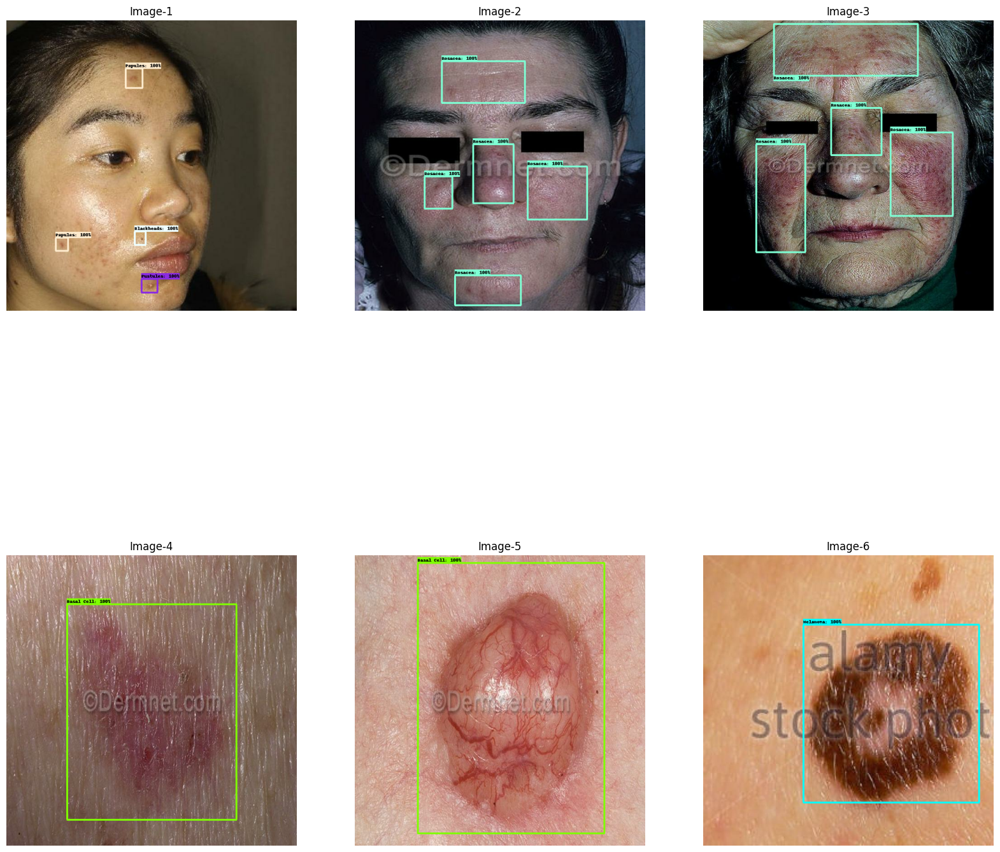

In [21]:
buffer_size = 20
num_of_examples = 6

raw_records = tf.data.TFRecordDataset(
    exp_config.task.train_data.input_path).shuffle(
        buffer_size=buffer_size).take(num_of_examples)
show_batch(raw_records, num_of_examples)

In [22]:
model, eval_logs = tfm.core.train_lib.run_experiment(
    distribution_strategy=distribution_strategy,
    task=task,
    mode='train_and_eval',
    params=exp_config,
    model_dir=model_dir,
    run_post_eval=True)

restoring or initializing model...
train | step:      0 | training until step 100...
train | step:    100 | steps/sec:    0.4 | output: 
    {'box_loss': 0.018048815,
     'cls_loss': 0.9484084,
     'learning_rate': 0.099726096,
     'model_loss': 1.8508492,
     'total_loss': 2.3554103,
     'training_loss': 2.3554103}
saved checkpoint to ./trained_model/ckpt-100.
 eval | step:    100 | running 100 steps of evaluation...
creating index...
index created!
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=1.50s).
Accumulating evaluation results...
DONE (t=0.28s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.018
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.054
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.002
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.004
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium 

In [23]:
%load_ext tensorboard
%tensorboard --logdir './trained_model/'

<IPython.core.display.Javascript object>

In [24]:
export_saved_model_lib.export_inference_graph(
    input_type='image_tensor',
    batch_size=1,
    input_image_size=[HEIGHT, WIDTH],
    params=exp_config,
    checkpoint_path=tf.train.latest_checkpoint(model_dir),
    export_dir=export_dir)

In [ ]:
def load_image_into_numpy_array(path):
  """Load an image from file into a numpy array.

  Puts image into numpy array to feed into tensorflow graph.
  Note that by convention we put it into a numpy array with shape
  (height, width, channels), where channels=3 for RGB.

  Args:
    path: the file path to the image

  Returns:
    uint8 numpy array with shape (img_height, img_width, 3)
  """
  image = None
  if(path.startswith('http')):
    response = urlopen(path)
    image_data = response.read()
    image_data = BytesIO(image_data)
    image = Image.open(image_data)
  else:
    image_data = tf.io.gfile.GFile(path, 'rb').read()
    image = Image.open(BytesIO(image_data))

  (im_width, im_height) = image.size
  return np.array(image.getdata()).reshape(
      (1, im_height, im_width, 3)).astype(np.uint8)



def build_inputs_for_object_detection(image, input_image_size):
  """Builds Object Detection model inputs for serving."""
  image, _ = resize_and_crop_image(
      image,
      input_image_size,
      padded_size=input_image_size,
      aug_scale_min=1.0,
      aug_scale_max=1.0)
  return image

In [ ]:
def show_batch_test(raw_records, num_of_examples):
  plt.figure(figsize=(20, 20))
  use_normalized_coordinates=True
  min_score_thresh = 0.30
  for i, serialized_example in enumerate(raw_records):
    plt.subplot(5, 5, i + 1)
    decoded_tensors = tf_ex_decoder.decode(serialized_example)
    image = decoded_tensors['image'].numpy().astype('uint8')
    scores = np.ones(shape=(len(decoded_tensors['groundtruth_boxes'])))
    visualization_utils.visualize_boxes_and_labels_on_image_array(
        image,
        decoded_tensors['groundtruth_boxes'].numpy(),
        decoded_tensors['groundtruth_classes'].numpy().astype('int'),
        scores,
        category_index=category_index,
        use_normalized_coordinates=use_normalized_coordinates,
        max_boxes_to_draw=200,
        min_score_thresh=min_score_thresh,
        agnostic_mode=False,
        instance_masks=None,
        line_thickness=4)

    plt.imshow(image)
    plt.axis('off')
    plt.title(f'Image-{i+1}')
  plt.show()

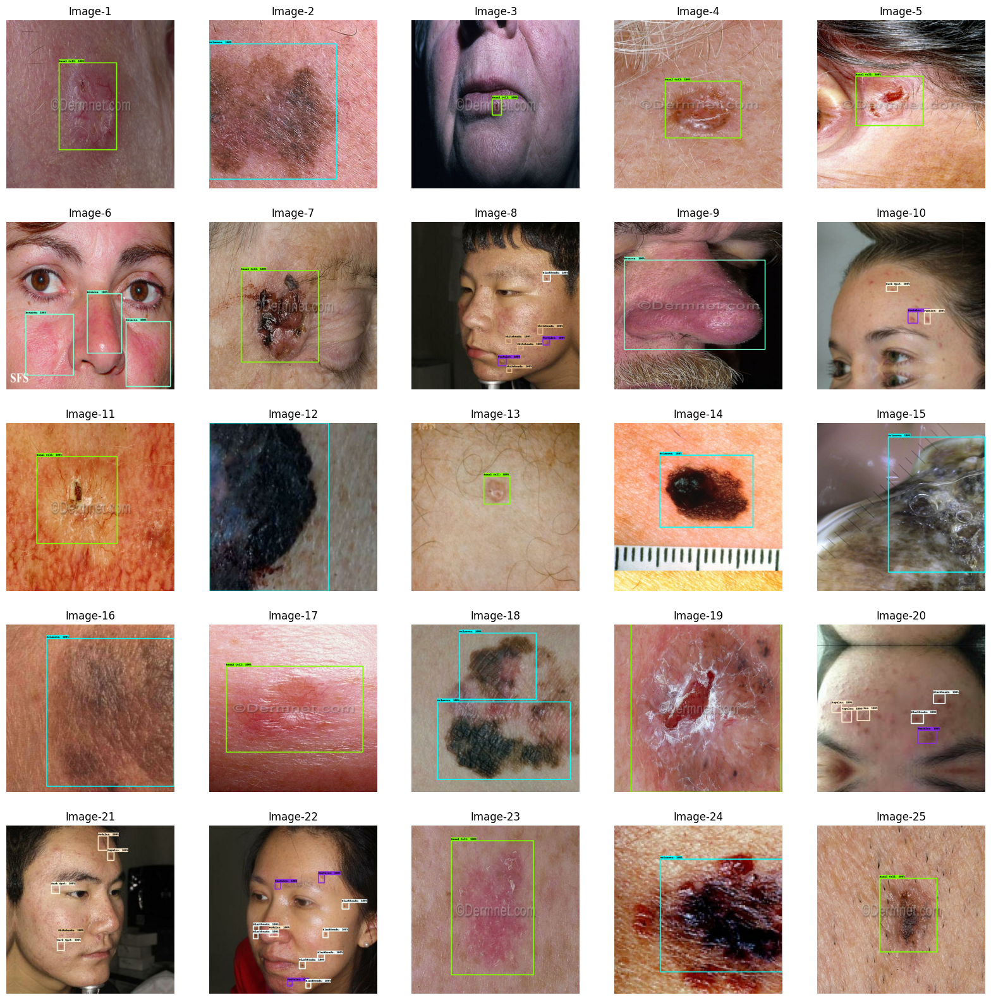

In [27]:
num_of_examples = 25

test_ds = tf.data.TFRecordDataset(
    './dermafie_coco_tfrecords/test-00000-of-00001.tfrecord').take(
        num_of_examples)
show_batch_test(test_ds, num_of_examples)

In [28]:
imported = tf.saved_model.load(export_dir)
model_fn = imported.signatures['serving_default']

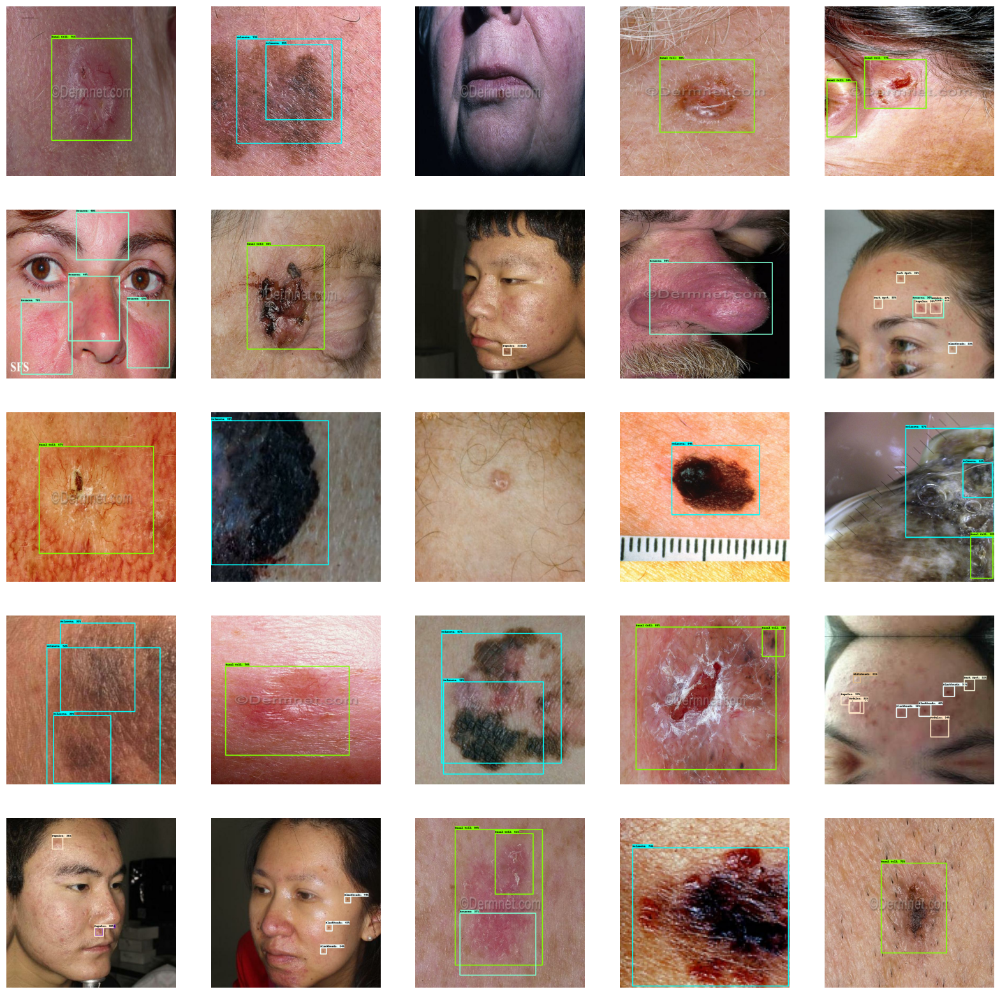

In [29]:
input_image_size = (HEIGHT, WIDTH)
plt.figure(figsize=(20, 20))
min_score_thresh = 0.30 # Change minimum score for threshold to see all bounding boxes confidences.

for i, serialized_example in enumerate(test_ds):
  plt.subplot(5, 5, i+1)
  decoded_tensors = tf_ex_decoder.decode(serialized_example)
  image = build_inputs_for_object_detection(decoded_tensors['image'], input_image_size)
  image = tf.expand_dims(image, axis=0)
  image = tf.cast(image, dtype = tf.uint8)
  image_np = image[0].numpy()
  result = model_fn(image)
  visualization_utils.visualize_boxes_and_labels_on_image_array(
      image_np,
      result['detection_boxes'][0].numpy(),
      result['detection_classes'][0].numpy().astype(int),
      result['detection_scores'][0].numpy(),
      category_index=category_index,
      use_normalized_coordinates=False,
      max_boxes_to_draw=200,
      min_score_thresh=min_score_thresh,
      agnostic_mode=False,
      instance_masks=None,
      line_thickness=4)
  plt.imshow(image_np)
  plt.axis('off')

plt.show()

In [30]:
!zip -r ./exported_model.zip ./exported_model
!zip -r ./checkpoint_model.zip ./trained_model

  adding: exported_model/ (stored 0%)
  adding: exported_model/saved_model.pb (deflated 91%)
  adding: exported_model/assets/ (stored 0%)
  adding: exported_model/variables/ (stored 0%)
  adding: exported_model/variables/variables.data-00000-of-00001 (deflated 7%)
  adding: exported_model/variables/variables.index (deflated 79%)
  adding: exported_model/params.yaml (deflated 70%)
  adding: exported_model/fingerprint.pb (stored 0%)
  adding: trained_model/ (stored 0%)
  adding: trained_model/ckpt-2800.index (deflated 83%)
  adding: trained_model/ckpt-2800.data-00000-of-00001 (deflated 7%)
  adding: trained_model/ckpt-2700.data-00000-of-00001 (deflated 7%)
  adding: trained_model/checkpoint (deflated 72%)
  adding: trained_model/ckpt-2700.index (deflated 83%)
  adding: trained_model/ckpt-2900.data-00000-of-00001 (deflated 7%)
  adding: trained_model/train/ (stored 0%)
  adding: trained_model/train/events.out.tfevents.1718033664.9601f8eacccc.1691.0.v2 (deflated 74%)
  adding: trained_mode

In [31]:
## TFLite Conversion
model = tf.saved_model.load(export_dir)
concrete_func = model.signatures[tf.saved_model.DEFAULT_SERVING_SIGNATURE_DEF_KEY]
concrete_func.inputs[0].set_shape([1, 640, 640, 3])
tf.saved_model.save(model, "exported_model_updated", signatures={"serving_default":concrete_func})
converter = tf.lite.TFLiteConverter.from_saved_model(saved_model_dir='exported_model_updated', signature_keys=['serving_default'])

converter.optimizations = [tf.lite.Optimize.DEFAULT]
converter.target_spec.supported_ops = [tf.lite.OpsSet.TFLITE_BUILTINS, tf.lite.OpsSet.SELECT_TF_OPS]
tflite_model = converter.convert()

open("dermafie_tflite_model.tflite", "wb").write(tflite_model)

## TFLite Interpreter to check input shape
interpreter = tf.lite.Interpreter(model_content=tflite_model)
interpreter.allocate_tensors()

# Get input and output tensors.
input_details = interpreter.get_input_details()
output_details = interpreter.get_output_details()

# Test the model on random input data.
input_shape = input_details[0]['shape']
print(input_shape)

[1 1 1 3]


In [32]:
!zip -r ./exported_model_updated.zip ./exported_model_updated

  adding: exported_model_updated/ (stored 0%)
  adding: exported_model_updated/saved_model.pb (deflated 91%)
  adding: exported_model_updated/assets/ (stored 0%)
  adding: exported_model_updated/variables/ (stored 0%)
  adding: exported_model_updated/variables/variables.data-00000-of-00001 (deflated 7%)
  adding: exported_model_updated/variables/variables.index (deflated 79%)
  adding: exported_model_updated/fingerprint.pb (stored 0%)


In [ ]:
# from google.colab import files
# files.download("./exported_model.zip")
# files.download("./checkpoint_model.zip")
# files.download("./exported_model_updated.zip")
# files.download("./dermafie_tflite_model.tflite")